
# Project: Forecast Electric power consumption - Tubas Electrical Company Data 2019

## Table of Content
<ul>
<li><a href="#intro">Introduction</a></li>
<li><a href="#wrangling">Data Preprocessing</a></li>
<li><a href="#analysis">Data Analysis</a></li>
<li><a href='#augm'> Data Augmentation</a></li>
<li><a href="#arima1">Modeling with ARIMA Befor Augmenting</a></li>
<li><a href="#prophet1">Modeling with Prophet Befor Augmenting</a></li>
<li><a href="#arima2">Modeling with ARIMA After Augmenting</a></li>
<li><a href="#prophet2">Modeling with Prophet Befor Augmenting</a></li>
<li><a href="#conclusions">Conclusions</a></li>
</ul>

<a id='intro'></a>
## Introduction

### Dataset Description 
>The data set contains 5 columns, that shows the current reads at that date and time, the data set where taken from Tubas Electrical Company, for the year 2019
### Variables description
> <ul>
    <li><b>Date</b> <br> The date </li>
    <li><b>Time_24_hour</b> <br> Time in 24 hour formate </li>
    <li><b>I1</b><br> Current read for phase 1 </li>
    <li><b>I2</b><br> Current read for phase 2 </li>
    <li><b>I3</b><br> Current read for phase 3 </li>
</ul>


<a id='wrangling'></a>
## Data Preprocessing
> <b>The data where sent by the company in a csv file that contains many attributes as appearing in this picture. </b>
![Tubas Electrical Company Data](rawData.png)


> <b>The needed columns where taken to a new xlsx file to be cleaned since there is many null values and these need to be fiiled </b>
![Tubas Electrical Company Data](rawData2.png)


> <b>a plot for the data After interpolating it. </b>
![3phases plot before cleaning](3phasesPlotBeforClean.png)
> <b>But as seen in the plot there is many outliers and these need to be corrected, after correcting them manualy the plot appears like this.</b>

![3phases plot After cleaning](3phasesPlotAfterClean.png)


> <b> The plot shows that there are some outlying in the last three months. But to be sure we reached out the company to ensure if that is normal or not, they have told us that is not normal and some interrupts was happening at that time. these intterups may be coused of some problems or issues in the company's Power transformers.
To get a more accurate results in our prediction we must fix these outliers, the outlying is happening in the last days of October and all of November and December, and the best values to get for these monthes is, get data From April, add nois to it, and replace the outlying in October with it, the same for March with November, and Febreury with December.
This is the plot After manpulating.</b>
![Data After Manpulating](DataAfterManpulation.png)

# Data Analysis

### Import Libraries

In [2]:
import pandas as pd
import math
import numpy as np

# ---------------------------------------
import matplotlib.pyplot as plt
import seaborn as sns
import pylab 
plt.rcParams['figure.figsize']=(17,5)

# ---------------------------------------
import plotly.express as px
import plotly.graph_objs as go
from plotly.offline import iplot

# ---------------------------------------
from prophet import Prophet
import holidays
from sklearn.metrics import mean_squared_error, mean_absolute_error

#----------------------------------------
from statsmodels.tsa.arima.model import ARIMA

import warnings
warnings.filterwarnings("ignore")

### Define Functions

In [3]:
def line_plot(df, date, I, text, y_tiltle, x_title):
    data = go.Scatter(x = df[date],
                      y = df[I],
                      mode = 'lines',
                      name = I)

    layout = go.Layout(title={'text': text,
                              'y':0.9,
                              'x':0.5,
                              'xanchor': 'center',
                              'yanchor': 'top'},
                       xaxis = dict(title = x_title),
                       yaxis = dict(title = y_tiltle),
                       template = 'plotly_dark')

    fig = go.Figure(data = data, layout = layout)
    iplot(fig)
    
# --------------------------------------------------------------------

def calc_acc(list1, list2):
    y_true = np.array(list1)
    y_pred = np.array(list2)
    
    mape = np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    
    accuracy_percentage = 100 - mape

    print("Mean Absolute Percentage Error (MAPE):", mape)
    print("Accuracy Percentage:", accuracy_percentage)

# --------------------------------------------------------------------
    
def line_3plot(df, date, columns, text, y_title, x_title):
    data = []
    for col in columns:
        trace = go.Scatter(
            x=df[date],
            y=df[col],
            mode='lines',
            name=col
        )
        data.append(trace)
    
    layout = go.Layout(
        title={
            'text': text,
            'y': 0.9,
            'x': 0.5,
            'xanchor': 'center',
            'yanchor': 'top'
        },
        xaxis=dict(title=x_title),
        yaxis=dict(title=y_title),
        template='plotly_dark'
    )
    
    fig = go.Figure(data=data, layout=layout)
    iplot(fig)

 #-----------------------------------------

def calc_order(df, train_len, steps,p_values, d_values, q_values) :
    p_ret = 0
    d_ret = 0
    q_ret = 0
    rmse = 1000
    for p in p_values:
        for d in d_values:
            for q in q_values:
                order=(p,d,q)
                train = df[:train_len]
                test = df[train_len:]
                model=ARIMA(train,order = (p,d,q))
                model_fit=model.fit()
                y_pred=model_fit.forecast(steps=steps)
                error=np.sqrt(mean_squared_error(test,y_pred))
                if error < rmse and error >= 0:
                    rmse = error
                    p_ret = p
                    d_ret = d
                    q_ret = q
    return [p_ret, d_ret, q_ret]

#--------------------------------------------

def plot_train_test(df,col,train_len):
    train = df[:train_len]
    test = df[train_len:]
    
    train_samples = go.Scatter(x = train.index,
                  y = train[col],
                  mode = 'lines',
                  name = 'Train')

    test_samples = go.Scatter(x = test.index,
                  y = test[col],
                  mode = 'lines',
                  name = 'Test')

    layout = go.Layout(title={'text': 'Train/test split',
                          'y':0.9,
                          'x':0.5,
                          'xanchor': 'center',
                          'yanchor': 'top'},
                   xaxis = dict(title = 'Datetime'),
                   yaxis = dict(title = 'current'),
                   template = 'plotly_dark')

    data = [train_samples, test_samples]
    fig = go.Figure(data = data, layout = layout)
    iplot(fig)

#--------------------------------------------

def arima_modeling(df, col, train_len, steps):
    p , d , q = calc_order(df, train_len, steps, (0, 4), (0, 3), (0, 4))
    data_train = df[:train_len]
    data_test = df[train_len:]
    data_model = ARIMA(data_train, order=(p, d, q))
    data_model_fit = data_model.fit()
    data_forecaste=data_model_fit.forecast(steps=steps)
    calc_acc(data_test[col].tolist(),data_forecaste.tolist())
    
#----------------------------------------

def prophet_modeling(df, tr, all) :
    train_len = math.floor((df.shape[0]*tr)/all)

    train = df[:train_len]
    test = df[train_len:]

    prophet_model = Prophet()
    prophet_model.fit(train)

    test_forecast = prophet_model.predict(test)
    
    calc_acc(test['y'].tolist(),test_forecast['yhat'].tolist())
    
    f, ax = plt.subplots(1)
    f.set_figheight(5)
    f.set_figwidth(15)

    # Plotting the training data
    ax.plot(pd.to_datetime(train['ds']), train['y'], label='Train Data', color='blue')

    # Plotting the test data
    ax.plot(pd.to_datetime(test['ds']), test['y'], label='Test Data', color='red', alpha=0.5)

    # Plotting the forecasted data
    ax.plot(pd.to_datetime(test_forecast['ds']), test_forecast['yhat'], label='Forecast', color='green')

    ax.fill_between(pd.to_datetime(test_forecast['ds']), 
                    test_forecast['yhat_lower'], 
                    test_forecast['yhat_upper'], 
                    color='green', alpha=0.5, label='Confidence Interval')

    plt.title("Prophet Model - Train, Test, and Forecast")
    plt.legend()
    plt.show()
    
# ---------------------------------------
def new_df(df, col, new_date, new_AEP, split):
    tmp_df = df[[col]].reset_index().rename(columns={'Datetime':new_date, 'AEP_MW':new_AEP})
    tmp_df = pd.DataFrame(tmp_df.resample(split, on='Datetime', origin = 'start').mean())
    tmp_df.reset_index(inplace=True)
    return tmp_df

# ---------------------------------------
def bar_plot(col1, col2, agg_func, title, xtitle, ytitle):
    data = go.Bar(x = df.groupby(col1).agg({col2: agg_func}). \
              reset_index()[col1],
              y = df.groupby(col1).agg({col2: agg_func}). \
              reset_index()[col2],
              text =round(df.groupby(col1).agg({col2: agg_func}).reset_index()[col2],2),
              textposition= 'outside')

    layout = go.Layout(title={'text': title,
                              'y':0.9,
                              'x':0.5,
                              'xanchor': 'center',
                              'yanchor': 'top'},
                       xaxis = dict(title = xtitle),
                       yaxis = dict(title = ytitle),
                       template = 'plotly_dark')

    fig = go.Figure(data = data, layout = layout)
    iplot(fig)
    
#-----------------------------------------

def bar_plot2(df, title) :
    ax = df.plot(
        kind='bar',
        title=title,
        legend=True,
        xlabel="Phases",
        ylabel="Percentage Accuracy",
        rot=0,
        figsize=(10, 4),
        edgecolor='black'
    )

    # Add lines for the maximum and minimum values
    max_value = df.max().max()
    min_value = df.min().min()

    plt.axhline(y=max_value, color='red', linestyle='--', linewidth=1, label=f'Max Value ({max_value})')
    plt.axhline(y=min_value, color='blue', linestyle='--', linewidth=1, label=f'Min Value ({min_value})')

    # Display the legend
    plt.legend()

    # Show the plot
    plt.show()
# ---------------------------------------
def MAPE(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100


### Data Understanding

In [3]:
# read the data
df = pd.read_csv("input_data2019.csv", parse_dates=['Datetime'],index_col='Datetime').sort_values('Datetime')
df.head()

,I1,I2,I3
Datetime,,,
2019-01-01 00:00:00,141.224344,141.851126,144.712441
2019-01-01 01:00:00,124.928353,122.933446,124.464044
2019-01-01 02:00:00,115.902869,114.001158,114.375987
2019-01-01 03:00:00,108.653699,107.037666,107.096276
2019-01-01 04:00:00,103.072493,99.546536,102.537506


In [4]:
# split days weeks months to facilitate EDA plots
df['date'] = df.index
df['hour'] = df['date'].dt.hour
df['day_of_week'] = df['date'].dt.dayofweek
df['weekday_name'] = df['date'].dt.day_name()
df['quarter'] = df['date'].dt.quarter
df['month'] = df['date'].dt.month
df['year'] = df['date'].dt.year
df['day_of_year'] = df['date'].dt.dayofyear
df['day_of_month'] = df['date'].dt.day

df = df.dropna()

<a id='analysis'></a>
## Exploratory Data Analysis

We first look at the data in general, based on hours, days, and then months (from 2004 to 2018).

In [5]:
line_3plot(df, 'date', ['I1','I2','I3'], 'Current - Hourly', 'Current', 'Year')

<b> dynamically plot: </b>

In [6]:
fig = px.line(df, x='date', y='I1', 
              title='Current phase 1 with Range Slider and Selectors', 
             )

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()


### Checking electric power consumption per days

In [7]:
scatter = [go.Scatter(x = df['hour'],
                      y = df['I1'],
                      mode ='markers',
                      marker = dict(color = df['I1'],
                                    showscale = True,
                                   colorscale = 'OrRd',
                                   colorbar = dict(title='I1'),
                                    size = 9,
                                    opacity = 0.55))]

layout = go.Layout(title={'text': "Current consumption by hour of day",
                          'y':0.9,
                          'x':0.5,
                          'xanchor': 'center',
                          'yanchor': 'top'},
                   xaxis = dict(title = 'Day'),
                   yaxis = dict(title = 'Current'),
                   template = 'plotly_dark')

fig = go.Figure(data = scatter, layout = layout)
iplot(fig)

In [8]:
bar_plot('month', 'I1', 'sum', 'Total current consumption per month', 
         'Month', 'Current')

### Checking the hourly trend of electric power consumption every day of the week

In [9]:
df_pivot = df.pivot_table(index=df['hour'], columns='weekday_name', values='I1',
               aggfunc='sum')
df_pivot = df_pivot[['Friday', 'Monday', 'Saturday', 'Sunday', 'Thursday', 'Tuesday',
       'Wednesday']].reset_index().rename(columns={'hour':'hour'})

In [10]:
Monday = go.Scatter(x = df_pivot['hour'],
                  y = df_pivot['Monday'],
                  mode = 'lines',
                  name = 'Monday')

Tuesday = go.Scatter(x = df_pivot['hour'],
                  y = df_pivot['Tuesday'],
                  mode = 'lines',
                  name = 'Tuesday')

Wednesday = go.Scatter(x = df_pivot['hour'],
                  y = df_pivot['Wednesday'],
                  mode = 'lines',
                  name = 'Wednesday')

Thursday = go.Scatter(x = df_pivot['hour'],
                  y = df_pivot['Thursday'],
                  mode = 'lines',
                  name = 'Thursday')

Friday = go.Scatter(x = df_pivot['hour'],
                  y = df_pivot['Friday'],
                  mode = 'lines',
                  name = 'Friday')

Saturday = go.Scatter(x = df_pivot['hour'],
                  y = df_pivot['Saturday'],
                  mode = 'lines',
                  name = 'Saturday')

Sunday = go.Scatter(x = df_pivot['hour'],
                  y = df_pivot['Sunday'],
                  mode = 'lines',
                  name = 'Sunday')

layout = go.Layout(title={'text': 'current consumption - hourly trends',
                          'y':0.9,
                          'x':0.5,
                          'xanchor': 'center',
                          'yanchor': 'top'},
                   xaxis = dict(title = 'Hour'),
                   yaxis = dict(title = 'Current'),
                   template = 'plotly_dark')

data = [Monday, Tuesday, Wednesday, Thursday, Friday, Saturday, Sunday]
fig = go.Figure(data = data, layout = layout)
iplot(fig)

<a id='arima1'></a>
## Modeling with Arima Before Augmenting
###  9 months train / 3 months test

In [11]:
# Arima model with 2019 Data 9 months train phase 1

df = pd.read_csv('input_data2019.csv')
df = df.dropna()

df_i1 = pd.DataFrame({
    'Datetime': df['Datetime'],
    'I1': df['I1']
});

df_i2 = pd.DataFrame({
    'Datetime': df['Datetime'],
    'I2': df['I2']
});
df_i3 = pd.DataFrame({
    'Datetime': df['Datetime'],
    'I3': df['I3']
});

df_i3.set_index('Datetime', inplace=True)

df_i2.set_index('Datetime', inplace=True)

df_i1.set_index('Datetime', inplace=True)

df.set_index('Datetime', inplace=True)

plot_train_test(df, 'I1', 6546)

print("Phase 1 modeling with Arima Model 9 months training / 3 months testing")
arima_modeling(df_i1, 'I1', 6546, 2207)

print("Phase 2 modeling with Arima Model 9 months training / 3 months testing")
arima_modeling(df_i2, 'I2', 6546, 2207)

print("Phase 3 modeling with Arima Model 9 months training / 3 months testing")
arima_modeling(df_i3, 'I3', 6546, 2207)

Phase 1 modeling with Arima Model 9 months training / 3 months testing
Mean Absolute Percentage Error (MAPE): 18.649480662269916
Accuracy Percentage: 81.35051933773008
Phase 2 modeling with Arima Model 9 months training / 3 months testing
Mean Absolute Percentage Error (MAPE): 19.67539401369991
Accuracy Percentage: 80.32460598630009
Phase 3 modeling with Arima Model 9 months training / 3 months testing
Mean Absolute Percentage Error (MAPE): 19.25056780251674
Accuracy Percentage: 80.74943219748326


## Modeling with Arima
###  10 months train / 2 months test

In [12]:
plot_train_test(df, 'I1', 7290)

print("Phase 1 modeling with Arima Model 10 months training / 2 months testing ")
arima_modeling(df_i1, 'I1', 7290, 1463)

print("Phase 2 modeling with Arima Model 10 months training / 2 months testing")
arima_modeling(df_i2, 'I2', 7290, 1463)

print("Phase 3 modeling with Arima Model 10 months training / 2 months testing")
arima_modeling(df_i3, 'I3', 7290, 1463)

Phase 1 modeling with Arima Model 10 months training / 2 months testing 
Mean Absolute Percentage Error (MAPE): 23.001287676488307
Accuracy Percentage: 76.9987123235117
Phase 2 modeling with Arima Model 10 months training / 2 months testing
Mean Absolute Percentage Error (MAPE): 23.98948924057302
Accuracy Percentage: 76.01051075942698
Phase 3 modeling with Arima Model 10 months training / 2 months testing
Mean Absolute Percentage Error (MAPE): 23.626976216084525
Accuracy Percentage: 76.37302378391547


## Modeling with Arima
### 11 months train / 1 month test

In [13]:
plot_train_test(df, 'I1', 8010)

print("Phase 1 modeling with Arima Model 11 months training / 1 month testing")
arima_modeling(df_i1, 'I1', 8010, 743)

print("Phase 2 modeling with Arima Model 11 months training / 1 month testing")
arima_modeling(df_i2, 'I2', 8010, 743)

print("Phase 3 modeling with Arima Model 11 months training / 1 month testing")
arima_modeling(df_i3, 'I3', 8010, 743)

Phase 1 modeling with Arima Model 11 months training / 1 month testing
Mean Absolute Percentage Error (MAPE): 23.533668637822018
Accuracy Percentage: 76.46633136217798
Phase 2 modeling with Arima Model 11 months training / 1 month testing
Mean Absolute Percentage Error (MAPE): 23.54751771888321
Accuracy Percentage: 76.45248228111679
Phase 3 modeling with Arima Model 11 months training / 1 month testing
Mean Absolute Percentage Error (MAPE): 22.990672661541176
Accuracy Percentage: 77.00932733845883


<a id='prophet1'> </a>
## Modeling with Prophet before Augmenting
###  9 months train / 3 months test

modeling with prophet phase 1 with 9 months train / 3 months test


00:02:49 - cmdstanpy - INFO - Chain [1] start processing
00:02:49 - cmdstanpy - INFO - Chain [1] done processing


Mean Absolute Percentage Error (MAPE): 20.597602674561426
Accuracy Percentage: 79.40239732543857


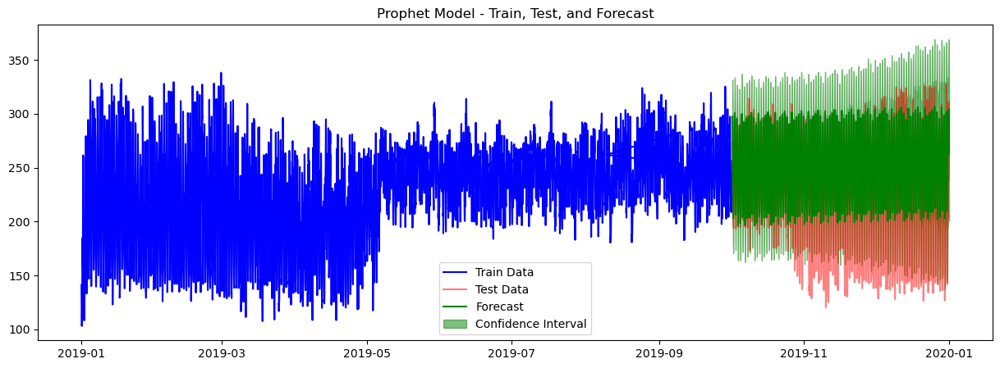

modeling with prophet phase 2 with 9 months train / 3 months test


00:02:53 - cmdstanpy - INFO - Chain [1] start processing
00:02:54 - cmdstanpy - INFO - Chain [1] done processing


Mean Absolute Percentage Error (MAPE): 21.547107572094664
Accuracy Percentage: 78.45289242790534


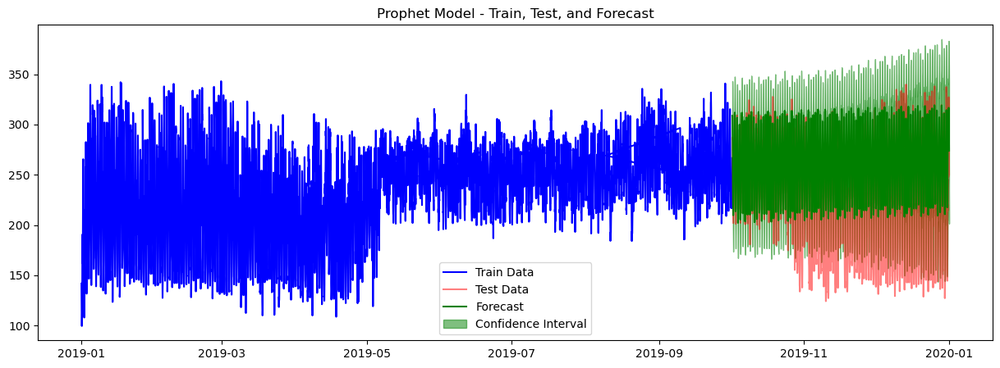

modeling with prophet phase 3 with 9 months train / 3 months test


00:02:57 - cmdstanpy - INFO - Chain [1] start processing
00:02:58 - cmdstanpy - INFO - Chain [1] done processing


Mean Absolute Percentage Error (MAPE): 20.748128930089592
Accuracy Percentage: 79.25187106991041


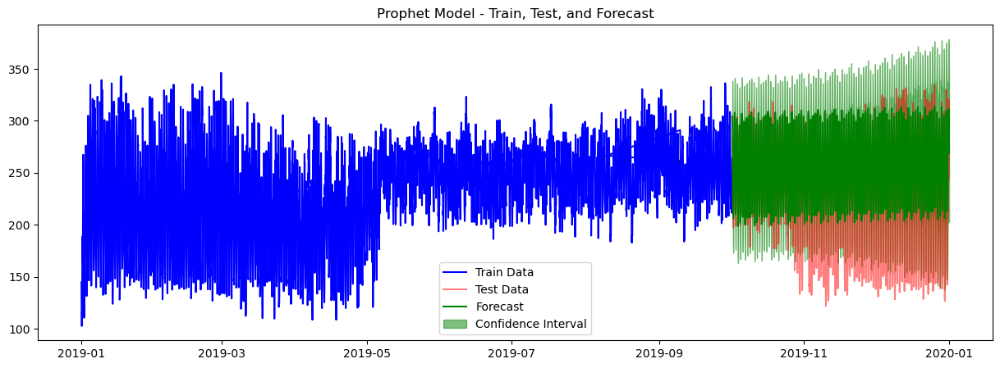

In [29]:
df = pd.read_csv('input_data2019.csv')
df = df.dropna()

df_i1 = pd.DataFrame({
    'ds': df['Datetime'],
    'y': df['I1']
});

df_i2 = pd.DataFrame({
    'ds': df['Datetime'],
    'y': df['I2']
});

df_i3 = pd.DataFrame({
    'ds': df['Datetime'],
    'y': df['I3']
});

df.set_index('Datetime', inplace=True)
plot_train_test(df, 'I1', 6546)

print("modeling with prophet phase 1 with 9 months train / 3 months test")
prophet_modeling(df_i1, 9, 12)

print("modeling with prophet phase 2 with 9 months train / 3 months test")
prophet_modeling(df_i2, 9, 12)

print("modeling with prophet phase 3 with 9 months train / 3 months test")
prophet_modeling(df_i3, 9, 12)


## Modeling with Prophet
### 10 months train / 2 months test

modeling with prophet phase 1 with 10 months train / 2 months test


00:03:01 - cmdstanpy - INFO - Chain [1] start processing
00:03:02 - cmdstanpy - INFO - Chain [1] done processing


Mean Absolute Percentage Error (MAPE): 13.973481718530008
Accuracy Percentage: 86.02651828146999


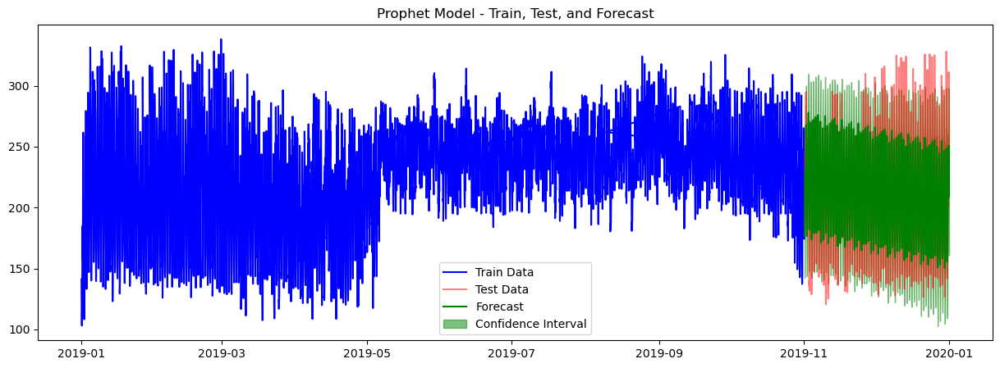

modeling with prophet phase 2 with 10 months train / 2 months test


00:03:04 - cmdstanpy - INFO - Chain [1] start processing
00:03:05 - cmdstanpy - INFO - Chain [1] done processing


Mean Absolute Percentage Error (MAPE): 14.453337624690194
Accuracy Percentage: 85.54666237530981


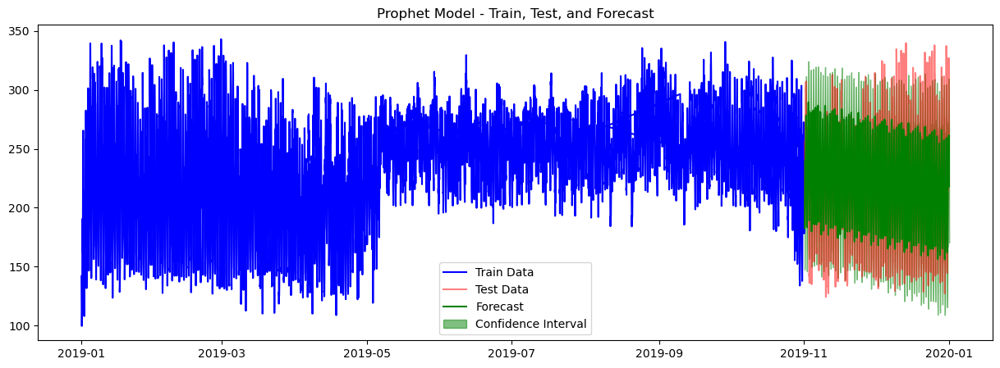

modeling with prophet phase 3 with 10 months train / 2 months test


00:03:08 - cmdstanpy - INFO - Chain [1] start processing
00:03:10 - cmdstanpy - INFO - Chain [1] done processing


Mean Absolute Percentage Error (MAPE): 14.02154769256185
Accuracy Percentage: 85.97845230743815


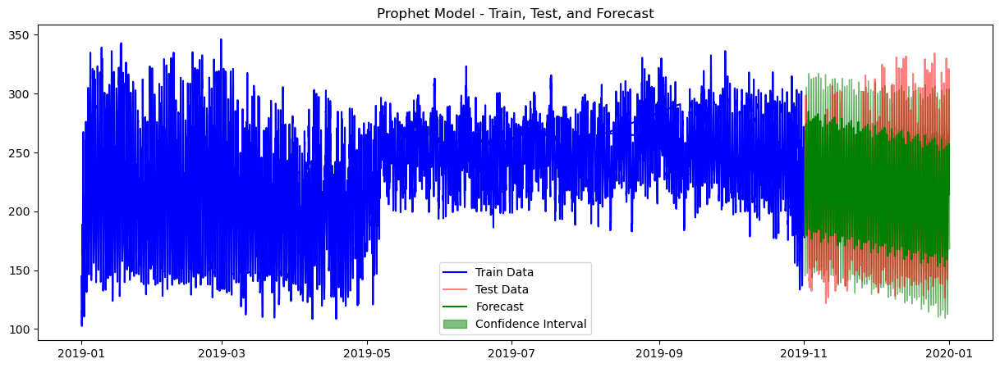

In [30]:
plot_train_test(df, 'I1', 7290)

print("modeling with prophet phase 1 with 10 months train / 2 months test")
prophet_modeling(df_i1, 10, 12)

print("modeling with prophet phase 2 with 10 months train / 2 months test")
prophet_modeling(df_i2, 10, 12)

print("modeling with prophet phase 3 with 10 months train / 2 months test")
prophet_modeling(df_i3, 10, 12)

## Modeling with Prophet
###  11 months train / 1 month test

modeling with prophet phase 1 with 11 months train / 1 month test


00:03:13 - cmdstanpy - INFO - Chain [1] start processing
00:03:15 - cmdstanpy - INFO - Chain [1] done processing


Mean Absolute Percentage Error (MAPE): 17.28967746135382
Accuracy Percentage: 82.71032253864618


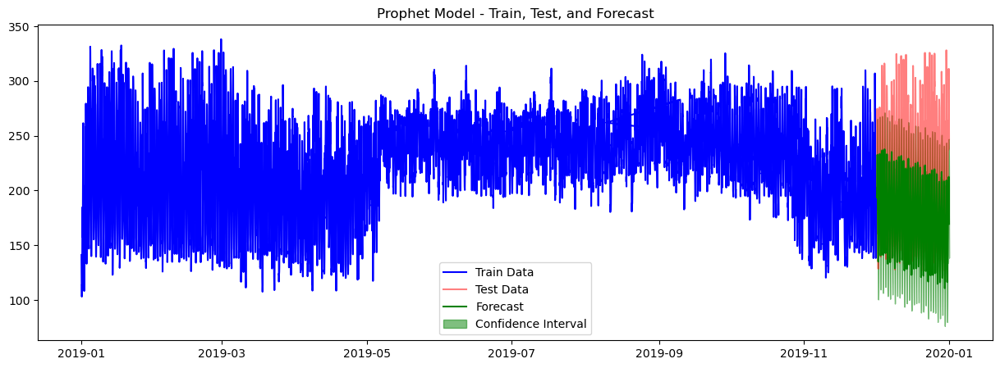

modeling with prophet phase 2 with 11 months train / 1 month test


00:03:17 - cmdstanpy - INFO - Chain [1] start processing
00:03:19 - cmdstanpy - INFO - Chain [1] done processing


Mean Absolute Percentage Error (MAPE): 16.93096840064496
Accuracy Percentage: 83.06903159935504


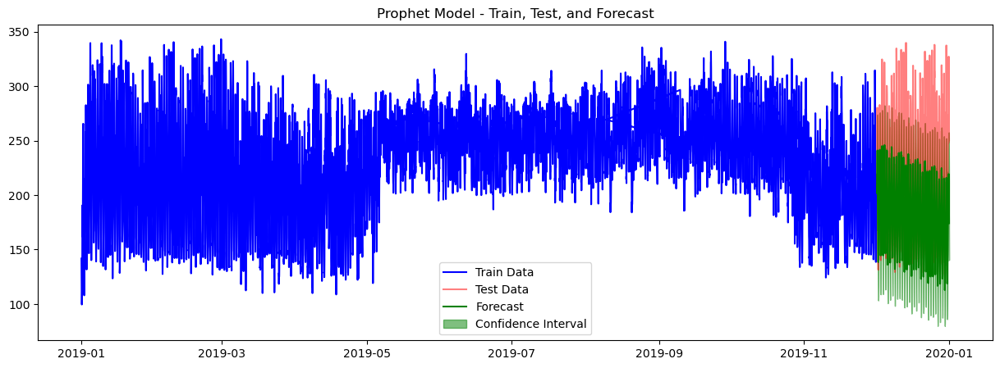

modeling with prophet phase 3 with 11 months train / 1 month test


00:03:22 - cmdstanpy - INFO - Chain [1] start processing
00:03:25 - cmdstanpy - INFO - Chain [1] done processing


Mean Absolute Percentage Error (MAPE): 16.925294576839754
Accuracy Percentage: 83.07470542316025


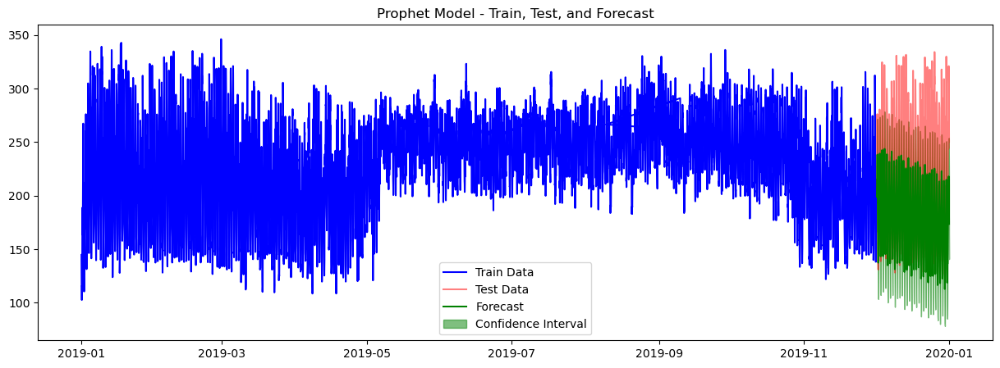

In [31]:
plot_train_test(df, 'I1', 8010)

print("modeling with prophet phase 1 with 11 months train / 1 month test")
prophet_modeling(df_i1, 11, 12)

print("modeling with prophet phase 2 with 11 months train / 1 month test")
prophet_modeling(df_i2, 11, 12)

print("modeling with prophet phase 3 with 11 months train / 1 month test")
prophet_modeling(df_i3, 11, 12)

<a id='augm'></a>
# Augment the data into 4 years

In [17]:

df = pd.read_csv('input_data2019.csv')

# Generate additional years
years_to_augment = 4
df_augmented = pd.concat([df] * years_to_augment, ignore_index=True)

# Update datetime column to cover five years
# Assuming your datetime column is named 'datetime'
# Assuming your datetime values are in hourly intervals
hours_per_year = 24 * 365
df_augmented['Datetime'] = pd.date_range(start=df['Datetime'].iloc[0], periods=len(df_augmented), freq='H')

# Add a little noise to the data
# You can adjust the noise level as needed
noise_level = 0.1  # 5% noise
columns_to_add_noise = ['I1', 'I2', 'I3']
for column in columns_to_add_noise:
    noise = np.random.normal(scale=df[column].std() * noise_level, size=len(df_augmented))
    df_augmented[column] += noise

# Save or further process the augmented data
# For example, you can save it to a new CSV file
#df_augmented.to_csv('input_data2019-augmented.csv', index=False)


In [ ]:
df = pd.read_csv("input_data2019-augmented.csv", parse_dates=['Datetime'],index_col='Datetime').sort_values('Datetime')
df.head()

# Augmented Data Analysis

In [ ]:
# split days weeks months to facilitate EDA plots
df['date'] = df.index
df['hour'] = df['date'].dt.hour
df['day_of_week'] = df['date'].dt.dayofweek
df['weekday_name'] = df['date'].dt.day_name()
df['quarter'] = df['date'].dt.quarter
df['month'] = df['date'].dt.month
df['year'] = df['date'].dt.year
df['day_of_year'] = df['date'].dt.dayofyear
df['day_of_month'] = df['date'].dt.day

df = df.dropna()

In [ ]:
line_3plot(df, 'date', ['I1','I2','I3'], 'Current Phases - Hourly', 'Current Phases', 'Year')

<a id='arima2'></a>
## Modeling with Arima after Augmenting
### 36 months train / 12 months test

In [21]:
# Arima model with 2019 Data 9 months train phase 1

df = pd.read_csv('input_data2019-augmented.csv')
df = df.dropna()

df_i1 = pd.DataFrame({
    'Datetime': df['Datetime'],
    'I1': df['I1']
});

df_i2 = pd.DataFrame({
    'Datetime': df['Datetime'],
    'I2': df['I2']
});
df_i3 = pd.DataFrame({
    'Datetime': df['Datetime'],
    'I3': df['I3']
});

df_i3.set_index('Datetime', inplace=True)

df_i2.set_index('Datetime', inplace=True)

df_i1.set_index('Datetime', inplace=True)

df.set_index('Datetime', inplace=True)

plot_train_test(df, 'I1', 26305)

print("Phase 1 modeling with Arima Model 36 months training / 12 months testing")
arima_modeling(df_i1, 'I1', 26305, 9095)

print("Phase 2 modeling with Arima Model 36 months training / 12 months testing")
arima_modeling(df_i2, 'I2', 26305, 9095)

print("Phase 3 modeling with Arima Model 36 months training / 12 months testing")
arima_modeling(df_i3, 'I3', 26305, 9095)


Phase 1 modeling with Arima Model 36 months training / 12 months testing
Mean Absolute Percentage Error (MAPE): 17.886065563848994
Accuracy Percentage: 82.113934436151
Phase 2 modeling with Arima Model 36 months training / 12 months testing
Mean Absolute Percentage Error (MAPE): 18.591055399773893
Accuracy Percentage: 81.4089446002261
Phase 3 modeling with Arima Model 36 months training / 12 months testing
Mean Absolute Percentage Error (MAPE): 17.985303083698657
Accuracy Percentage: 82.01469691630135


## Modeling with Arima
### 42 months train / 6 months test

In [22]:
plot_train_test(df, 'I1', 30649)

print("Phase 1 modeling with Arima Model 42 months training / 6 months testing")
arima_modeling(df_i1, 'I1', 30649, 4751)

print("Phase 2 modeling with Arima Model 42 months training / 6 months testing")
arima_modeling(df_i2, 'I2', 30649, 4751)

print("Phase 3 modeling with Arima Model 42 months training / 6 months testing")
arima_modeling(df_i3, 'I3', 30649, 4751)


Phase 1 modeling with Arima Model 42 months training / 6 months testing
Mean Absolute Percentage Error (MAPE): 15.008921847017861
Accuracy Percentage: 84.99107815298214
Phase 2 modeling with Arima Model 42 months training / 6 months testing
Mean Absolute Percentage Error (MAPE): 15.391442623718035
Accuracy Percentage: 84.60855737628196
Phase 3 modeling with Arima Model 42 months training / 6 months testing
Mean Absolute Percentage Error (MAPE): 15.11505493718549
Accuracy Percentage: 84.88494506281451


## Modeling with Arima
### 45 months train / 3 months test

In [23]:
plot_train_test(df, 'I1', 32857)

print("Phase 1 modeling with Arima Model 45 months training / 3 months testing")
arima_modeling(df_i1, 'I1', 32857, 2543)

print("Phase 2 modeling with Arima Model 45 months training / 3 months testing")
arima_modeling(df_i2, 'I2', 32857, 2543)

print("Phase 3 modeling with Arima Model 45 months training / 3 months testing")
arima_modeling(df_i3, 'I3', 32857, 2543)

Phase 1 modeling with Arima Model 45 months training / 3 months testing
Mean Absolute Percentage Error (MAPE): 18.52971137660748
Accuracy Percentage: 81.47028862339252
Phase 2 modeling with Arima Model 45 months training / 3 months testing
Mean Absolute Percentage Error (MAPE): 19.24910462610214
Accuracy Percentage: 80.75089537389786
Phase 3 modeling with Arima Model 45 months training / 3 months testing
Mean Absolute Percentage Error (MAPE): 18.877736664639677
Accuracy Percentage: 81.12226333536032


<a id='prophet2'></a>
## Modeling with prophet after Augmenting
### 36 months training, 12 months testing

modeling with prophet phase 1 with 36 months train / 12 months test


00:00:58 - cmdstanpy - INFO - Chain [1] start processing
00:01:03 - cmdstanpy - INFO - Chain [1] done processing


Mean Absolute Percentage Error (MAPE): 17.489609839268795
Accuracy Percentage: 82.5103901607312


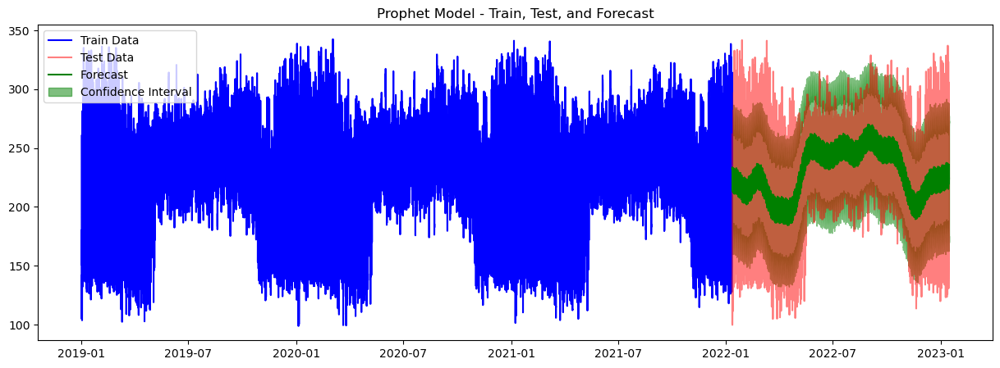

modeling with prophet phase 2 with 36 months train / 12 months test


00:01:16 - cmdstanpy - INFO - Chain [1] start processing
00:01:21 - cmdstanpy - INFO - Chain [1] done processing


Mean Absolute Percentage Error (MAPE): 17.99975873927202
Accuracy Percentage: 82.00024126072798


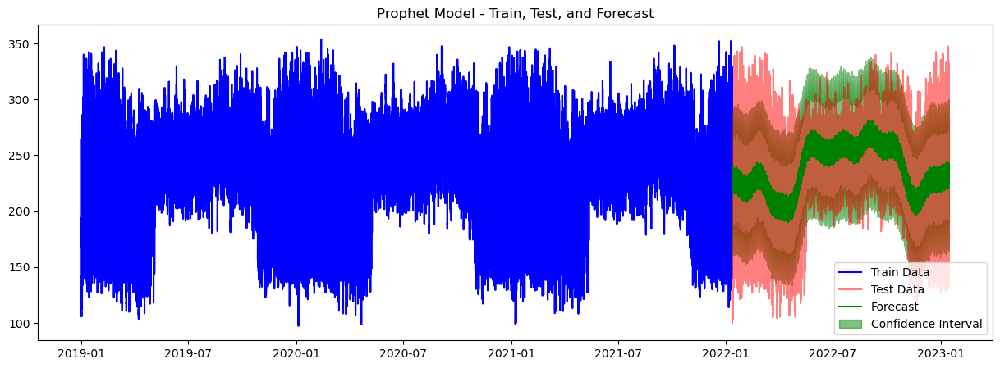

modeling with prophet phase 3 with 36 months train / 12 months test


00:01:35 - cmdstanpy - INFO - Chain [1] start processing
00:01:40 - cmdstanpy - INFO - Chain [1] done processing


Mean Absolute Percentage Error (MAPE): 17.71124350662497
Accuracy Percentage: 82.28875649337503


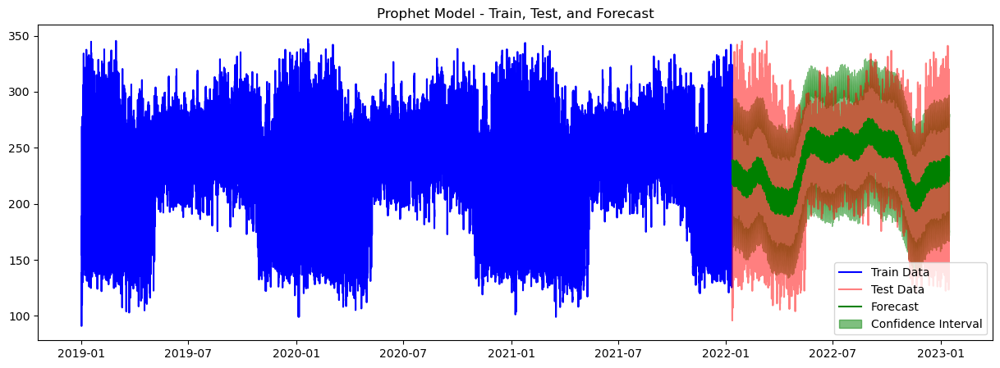

In [28]:
df = pd.read_csv('input_data2019-augmented.csv')
df = df.dropna()

df_i1 = pd.DataFrame({
    'ds': df['Datetime'],
    'y': df['I1']
});

df_i2 = pd.DataFrame({
    'ds': df['Datetime'],
    'y': df['I2']
});

df_i3 = pd.DataFrame({
    'ds': df['Datetime'],
    'y': df['I3']
});

df.set_index('Datetime', inplace=True)
plot_train_test(df, 'I1', 26305)

print("modeling with prophet phase 1 with 36 months train / 12 months test")
prophet_modeling(df_i1, 36, 48)

print("modeling with prophet phase 2 with 36 months train / 12 months test")
prophet_modeling(df_i2, 36, 48)

print("modeling with prophet phase 3 with 36 months train / 12 months test")
prophet_modeling(df_i3, 36, 48)


# Modeling with prophet
### 42 months training, 6 months testing

modeling with prophet phase 1 with 42 months train / 6 months test


00:00:04 - cmdstanpy - INFO - Chain [1] start processing
00:00:08 - cmdstanpy - INFO - Chain [1] done processing


Mean Absolute Percentage Error (MAPE): 14.615484068382276
Accuracy Percentage: 85.38451593161773


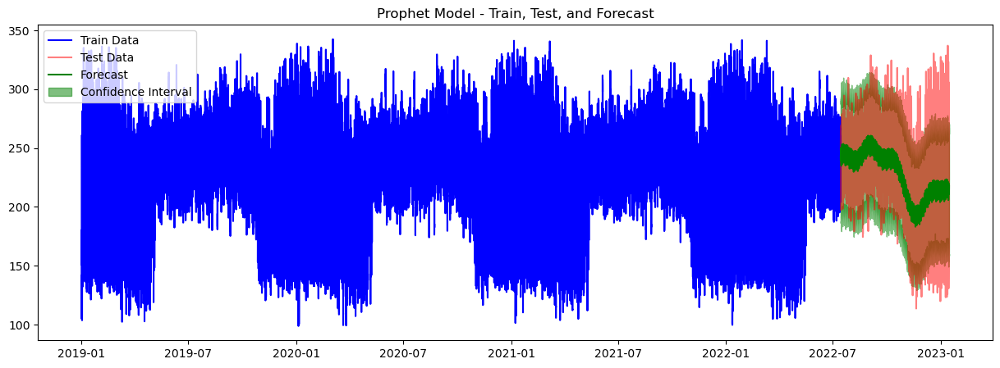

modeling with prophet phase 2 with 42 months train / 6 months test


00:00:23 - cmdstanpy - INFO - Chain [1] start processing
00:00:28 - cmdstanpy - INFO - Chain [1] done processing


Mean Absolute Percentage Error (MAPE): 14.998275262333074
Accuracy Percentage: 85.00172473766693


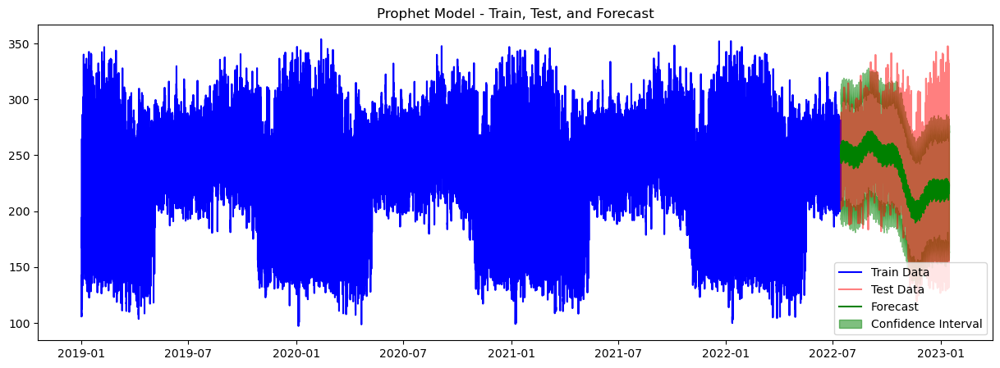

modeling with prophet phase 3 with 42 months train / 6 months test


00:00:40 - cmdstanpy - INFO - Chain [1] start processing
00:00:46 - cmdstanpy - INFO - Chain [1] done processing


Mean Absolute Percentage Error (MAPE): 14.736903196715524
Accuracy Percentage: 85.26309680328447


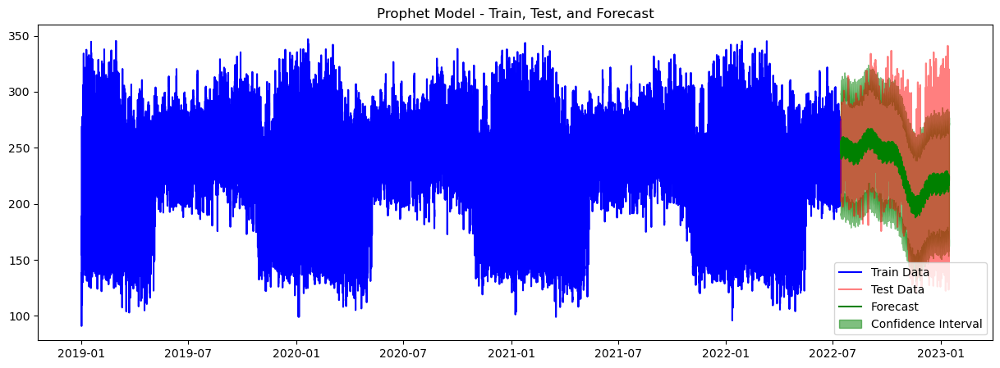

In [27]:
plot_train_test(df, 'I1', 30649)

print("modeling with prophet phase 1 with 42 months train / 6 months test")
prophet_modeling(df_i1, 42, 48)

print("modeling with prophet phase 2 with 42 months train / 6 months test")
prophet_modeling(df_i2, 42, 48)

print("modeling with prophet phase 3 with 42 months train / 6 months test")
prophet_modeling(df_i3, 42, 48)


# Modeling with prophet
### 45 months training, 6 months testing

modeling with prophet phase 1 with 45 months train / 3 months test


23:59:17 - cmdstanpy - INFO - Chain [1] start processing
23:59:21 - cmdstanpy - INFO - Chain [1] done processing


Mean Absolute Percentage Error (MAPE): 18.926279716880465
Accuracy Percentage: 81.07372028311954


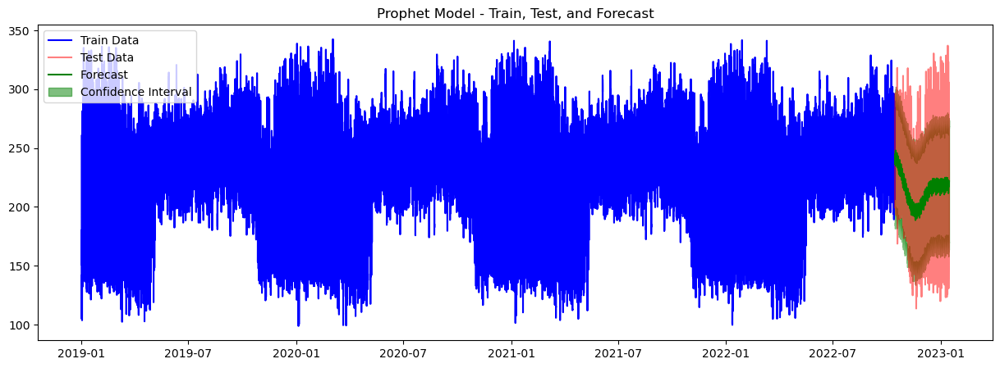

modeling with prophet phase 2 with 45 months train / 3 months test


23:59:32 - cmdstanpy - INFO - Chain [1] start processing
23:59:36 - cmdstanpy - INFO - Chain [1] done processing


Mean Absolute Percentage Error (MAPE): 19.398102897486016
Accuracy Percentage: 80.60189710251399


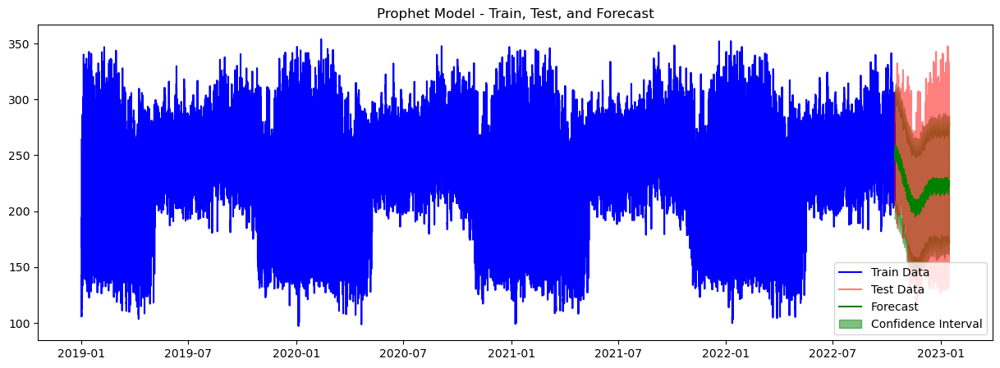

modeling with prophet phase 3 with 45 months train / 3 months test


23:59:47 - cmdstanpy - INFO - Chain [1] start processing
23:59:54 - cmdstanpy - INFO - Chain [1] done processing


Mean Absolute Percentage Error (MAPE): 19.072295776583147
Accuracy Percentage: 80.92770422341685


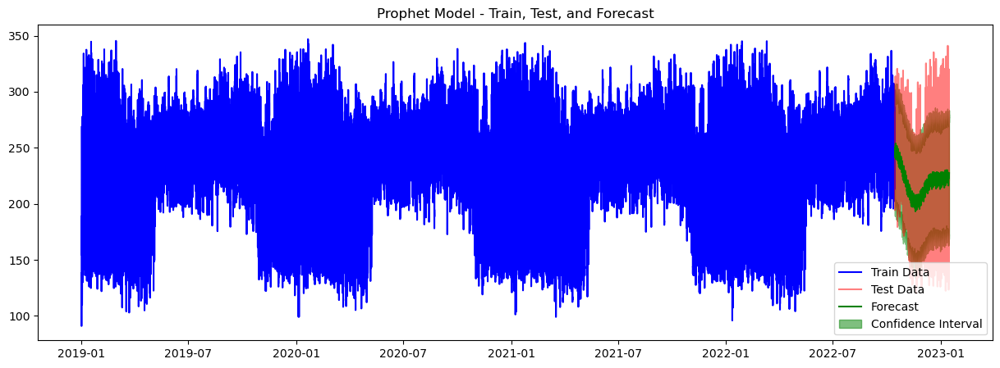

In [26]:
plot_train_test(df, 'I1', 32857)
print("modeling with prophet phase 1 with 45 months train / 3 months test")
prophet_modeling(df_i1, 45, 48)

print("modeling with prophet phase 2 with 45 months train / 3 months test")
prophet_modeling(df_i2, 45, 48)

print("modeling with prophet phase 3 with 45 months train / 3 months test")
prophet_modeling(df_i3, 45, 48)


<a id='conclusions'></a>
# Conclosion
### Analysis of the results before augmenting
<b> lets compare results of prophet and arima with the data before augmenting</b>

<Axes: title={'center': 'Results of predicting using Arima vs Prophet with 9 months train / 3 months test'}, xlabel='Phases', ylabel='percentage accuracy'>

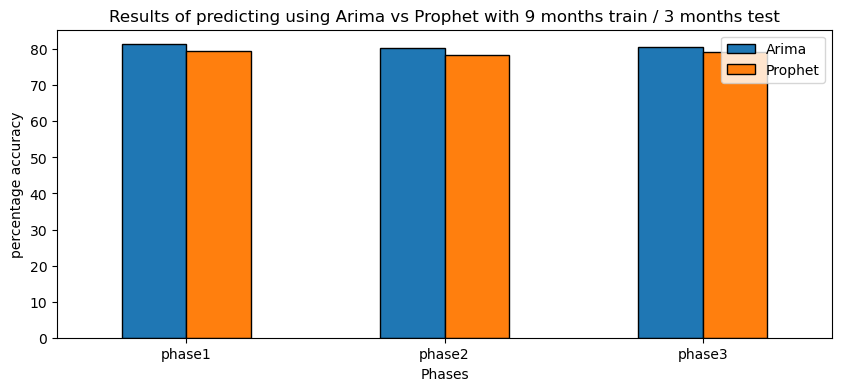

In [41]:
df = pd.DataFrame({
    'Phase': ['phase1', 'phase2', 'phase3'],
    'Arima': [81.35, 80.32, 80.74],
    'Prophet': [79.40, 78.45, 79.25]
})
df.set_index('Phase', inplace=True)
df.plot(
    kind='bar',
    title='Results of predicting using Arima vs Prophet with 9 months train / 3 months test',
    legend=True,
    xlabel="Phases",
    ylabel="percentage accuracy",
    rot=0,
    figsize=(10, 4),
    edgecolor='black'
)

<Axes: title={'center': 'Results of predicting using Arima vs Prophet with 10 months train / 3 months test'}, xlabel='Phases', ylabel='percentage accuracy'>

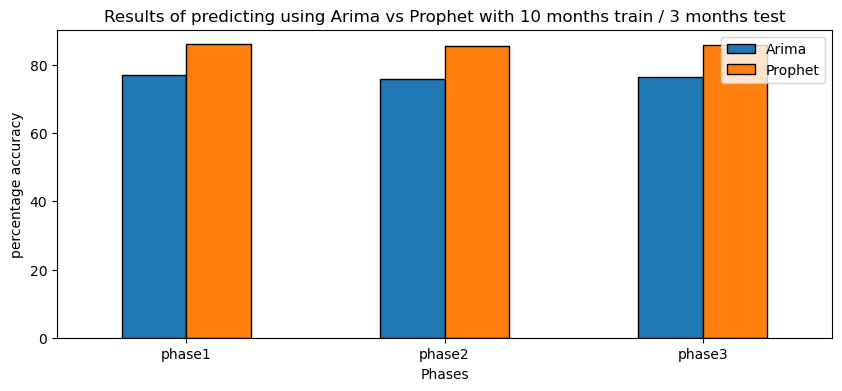

In [42]:
df = pd.DataFrame({
    'Phase': ['phase1', 'phase2', 'phase3'],
    'Arima': [77.00, 76.01, 76.37],
    'Prophet': [86.03, 85.55, 85.98]
})
df.set_index('Phase', inplace=True)
df.plot(
    kind='bar',
    title='Results of predicting using Arima vs Prophet with 10 months train / 3 months test',
    legend=True,
    xlabel="Phases",
    ylabel="percentage accuracy",
    rot=0,
    figsize=(10, 4),
    edgecolor='black'
)

<Axes: title={'center': 'Results of predicting using Arima vs Prophet with 11 months train / 1 months test'}, xlabel='Phases', ylabel='percentage accuracy'>

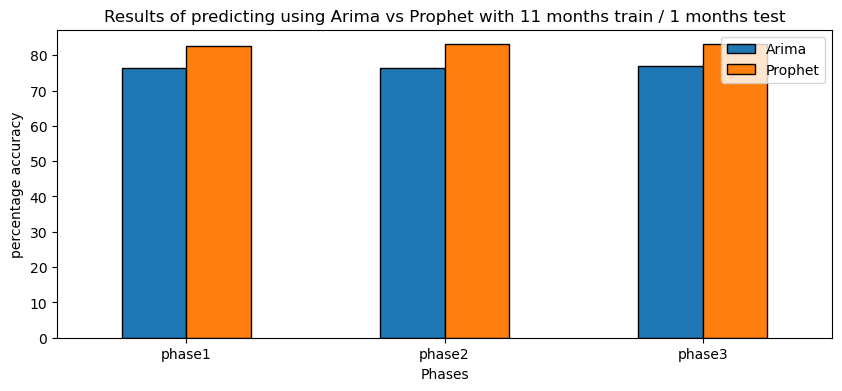

In [43]:
df = pd.DataFrame({
    'Phase': ['phase1', 'phase2', 'phase3'],
    'Arima': [76.46, 76.45, 77.01],
    'Prophet': [82.71, 83.06, 83.07]
})
df.set_index('Phase', inplace=True)
df.plot(
    kind='bar',
    title='Results of predicting using Arima vs Prophet with 11 months train / 1 months test',
    legend=True,
    xlabel="Phases",
    ylabel="percentage accuracy",
    rot=0,
    figsize=(10, 4),
    edgecolor='black'
)

<b> These plots shows that as the training period increases the prophet predicting result gets better than Arima, when the period where 9/3 train to test arima gave a better results with very little difference that does not exceed 0.02, but when the period of training increased the results of prophet got clearly better</b>


<b> Now lets analyze the results of each model with the different training perriods </b>

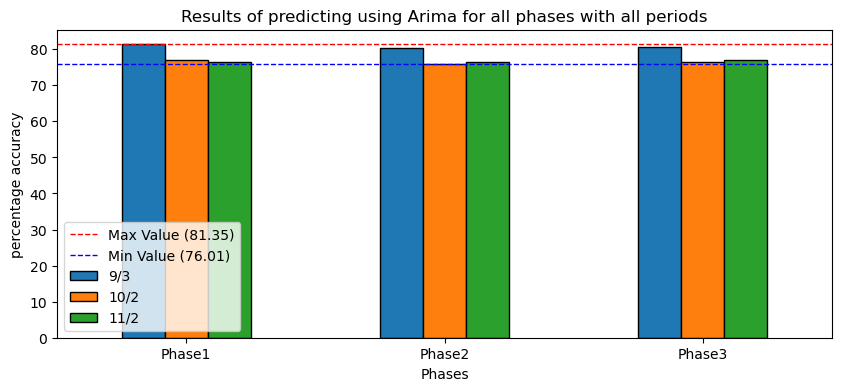

In [44]:
arima = pd.DataFrame({
    'Phases': ['Phase1', 'Phase2', 'Phase3'],
    '9/3': [81.35,80.32,80.74],
    '10/2': [77.00, 76.01, 76.37],
    '11/2': [76.46, 76.45, 77.01]
})
arima.set_index('Phases', inplace=True)
arima.plot(
    kind='bar',
    title='Results of predicting using Arima for all phases with all periods',
    legend=True,
    xlabel="Phases",
    ylabel="percentage accuracy",
    rot=0,
    figsize=(10, 4),
    edgecolor='black'
)

max_value = arima.max().max()
min_value = arima.min().min()

plt.axhline(y=max_value, color='red', linestyle='--', linewidth=1, label=f'Max Value ({max_value})')
plt.axhline(y=min_value, color='blue', linestyle='--', linewidth=1, label=f'Min Value ({min_value})')

# Display the legend
plt.legend()

# Show the plot
plt.show()

<b> For arima when the period where shorter the results where more accurated, and the increase with the period of training did not directly affected the result.</b>

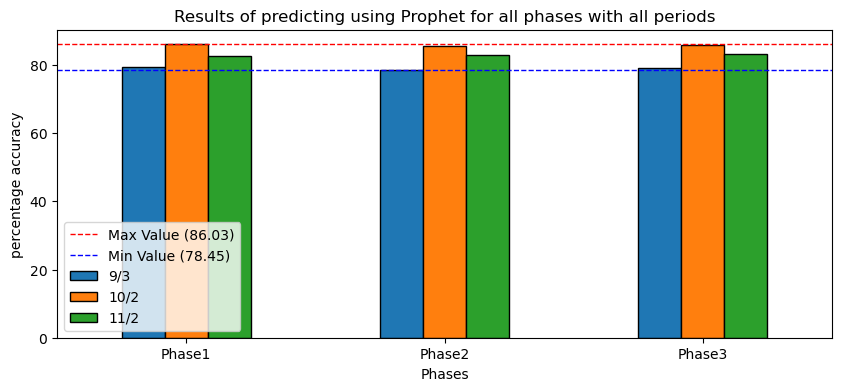

In [31]:
prophet = pd.DataFrame({
    'Phases': ['Phase1', 'Phase2', 'Phase3'],
    '9/3': [79.40, 78.45, 79.25],
    '10/2': [86.03, 85.55, 85.98],
    '11/2': [82.71, 83.06, 83.07]
})
prophet.set_index('Phases', inplace=True)
prophet.plot(
    kind='bar',
    title='Results of predicting using Prophet for all phases with all periods',
    legend=True,
    xlabel="Phases",
    ylabel="percentage accuracy",
    rot=0,
    figsize=(10, 4),
    edgecolor='black'
)

max_value = prophet.max().max()
min_value = prophet.min().min()

plt.axhline(y=max_value, color='red', linestyle='--', linewidth=1, label=f'Max Value ({max_value})')
plt.axhline(y=min_value, color='blue', linestyle='--', linewidth=1, label=f'Min Value ({min_value})')

# Display the legend
plt.legend()

# Show the plot
plt.show()

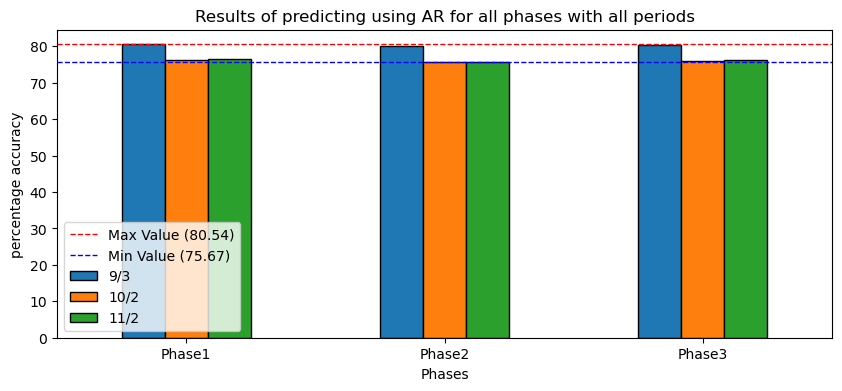

In [6]:
AR = pd.DataFrame({
    'Phases': ['Phase1', 'Phase2', 'Phase3'],
    '9/3': [80.54, 80.05, 80.37],
    '10/2': [76.28, 75.67, 76.02],
    '11/2': [76.45, 75.67, 76.13]
})
AR.set_index('Phases', inplace=True)
AR.plot(
    kind='bar',
    title='Results of predicting using AR for all phases with all periods',
    legend=True,
    xlabel="Phases",
    ylabel="percentage accuracy",
    rot=0,
    figsize=(10, 4),
    edgecolor='black'
)

max_value = AR.max().max()
min_value = AR.min().min()

plt.axhline(y=max_value, color='red', linestyle='--', linewidth=1, label=f'Max Value ({max_value})')
plt.axhline(y=min_value, color='blue', linestyle='--', linewidth=1, label=f'Min Value ({min_value})')

# Display the legend
plt.legend()

# Show the plot
plt.show()

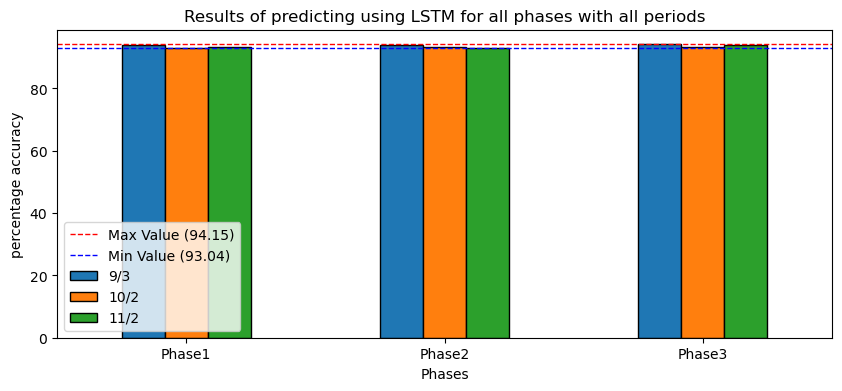

In [5]:
LSTM = pd.DataFrame({
    'Phases': ['Phase1', 'Phase2', 'Phase3'],
    '9/3': [94.05, 93.85, 94.15],
    '10/2': [93.04, 93.38, 93.39],
    '11/2': [93.46, 93.13, 94.01]
})
LSTM.set_index('Phases', inplace=True)
LSTM.plot(
    kind='bar',
    title='Results of predicting using LSTM for all phases with all periods',
    legend=True,
    xlabel="Phases",
    ylabel="percentage accuracy",
    rot=0,
    figsize=(10, 4),
    edgecolor='black'
)

max_value = LSTM.max().max()
min_value = LSTM.min().min()

plt.axhline(y=max_value, color='red', linestyle='--', linewidth=1, label=f'Max Value ({max_value})')
plt.axhline(y=min_value, color='blue', linestyle='--', linewidth=1, label=f'Min Value ({min_value})')

# Display the legend
plt.legend()

# Show the plot
plt.show()

<b> For prophet when the period where shorter the results where less accurated, and the increase with the period of training increased the accuracy. The difference with the first and second periods has exceeded 0.05. the last period where not better then the second but also not worse than the first, and the difference between the second and the third period where smaller then the period between the first and the second.</b>

### Analysis of the results before augmenting
<b> lets compare results of prophet and arima with the data before augmenting</b>

<Axes: title={'center': 'Results of predicting using Arima vs Prophet with 36 months train / 12 months test'}, xlabel='Phases', ylabel='percentage accuracy'>

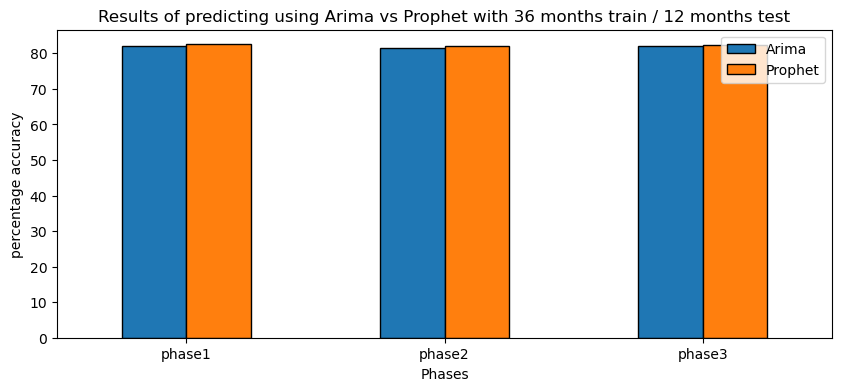

In [32]:
df = pd.DataFrame({
    'Phase': ['phase1', 'phase2', 'phase3'],
    'Arima': [82.11, 81.39, 82.01],
    'Prophet': [82.51, 82.00, 82.28]
})
df.set_index('Phase', inplace=True)
df.plot(
    kind='bar',
    title='Results of predicting using Arima vs Prophet with 36 months train / 12 months test',
    legend=True,
    xlabel="Phases",
    ylabel="percentage accuracy",
    rot=0,
    figsize=(10, 4),
    edgecolor='black'
)

<Axes: title={'center': 'Results of predicting using Arima vs Prophet with 42 months train / 6 months test'}, xlabel='Phases', ylabel='percentage accuracy'>

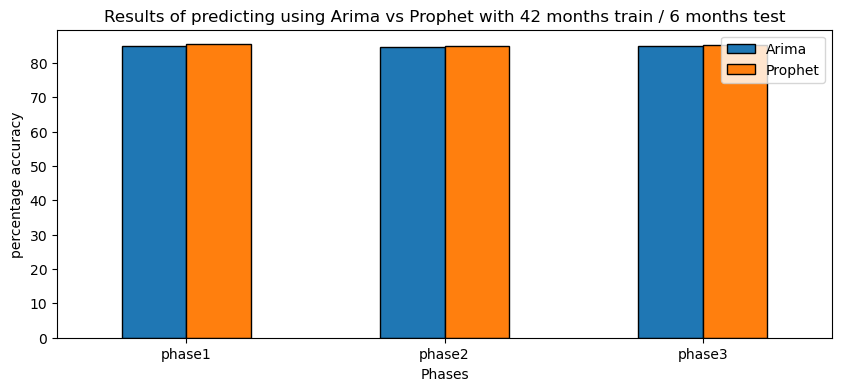

In [33]:
df = pd.DataFrame({
    'Phase': ['phase1', 'phase2', 'phase3'],
    'Arima': [84.99, 84.60, 84.88],
    'Prophet': [85.38, 85.00, 85.26]
})
df.set_index('Phase', inplace=True)
df.plot(
    kind='bar',
    title='Results of predicting using Arima vs Prophet with 42 months train / 6 months test',
    legend=True,
    xlabel="Phases",
    ylabel="percentage accuracy",
    rot=0,
    figsize=(10, 4),
    edgecolor='black'
)

<Axes: title={'center': 'Results of predicting using Arima vs Prophet with 45 months train / 3 months test'}, xlabel='Phases', ylabel='percentage accuracy'>

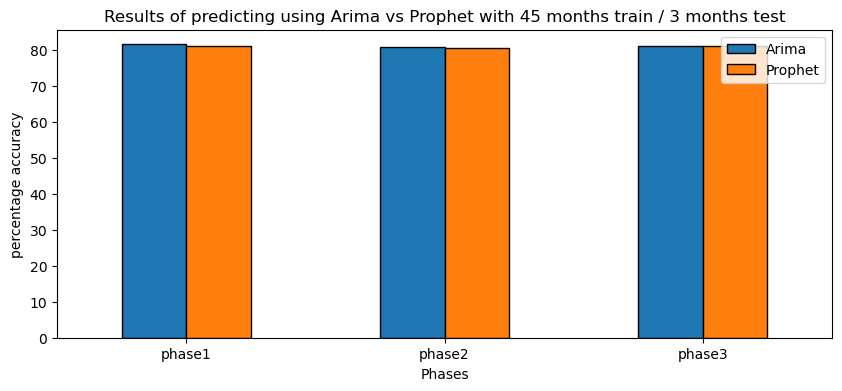

In [34]:
df = pd.DataFrame({
    'Phase': ['phase1', 'phase2', 'phase3'],
    'Arima': [81.47, 80.75, 81.12],
    'Prophet': [81.07, 80.60, 80.93]
})
df.set_index('Phase', inplace=True)
df.plot(
    kind='bar',
    title='Results of predicting using Arima vs Prophet with 45 months train / 3 months test',
    legend=True,
    xlabel="Phases",
    ylabel="percentage accuracy",
    rot=0,
    figsize=(10, 4),
    edgecolor='black'
)

The difference between the two models seem to be very littel with the augmented data

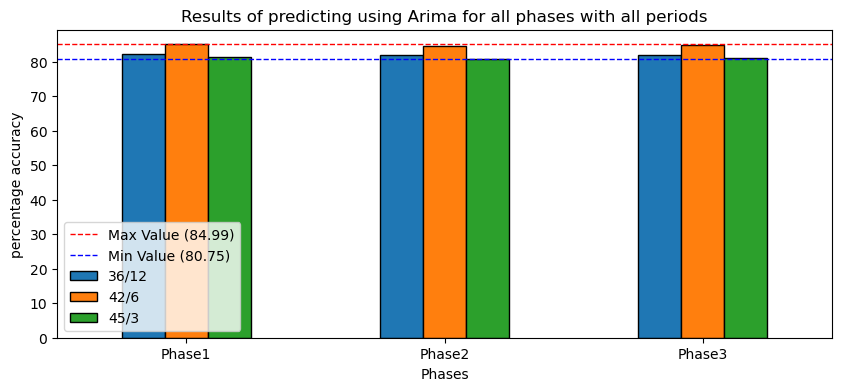

In [35]:
arima = pd.DataFrame({
    'Phases': ['Phase1', 'Phase2', 'Phase3'],
    '36/12': [82.11,81.93,82.01],
    '42/6': [84.99, 84.60, 84.88],
    '45/3': [81.47, 80.75, 81.12]
})
arima.set_index('Phases', inplace=True)
ax = arima.plot(
    kind='bar',
    title='Results of predicting using Arima for all phases with all periods',
    legend=True,
    xlabel="Phases",
    ylabel="percentage accuracy",
    rot=0,
    figsize=(10, 4),
    edgecolor='black'
)

max_value = arima.max().max()
min_value = arima.min().min()

plt.axhline(y=max_value, color='red', linestyle='--', linewidth=1, label=f'Max Value ({max_value})')
plt.axhline(y=min_value, color='blue', linestyle='--', linewidth=1, label=f'Min Value ({min_value})')

# Display the legend
plt.legend()

# Show the plot
plt.show()

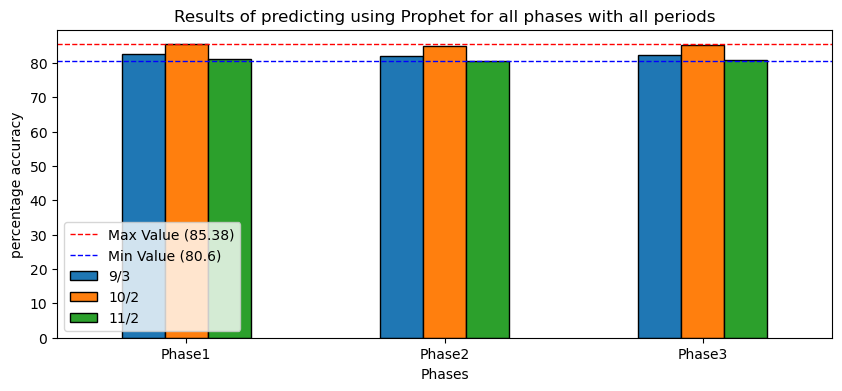

In [36]:
prophet = pd.DataFrame({
    'Phases': ['Phase1', 'Phase2', 'Phase3'],
    '36/12': [82.51, 82.00, 82.28],
    '42/6': [85.38, 85.00, 85.26],
    '45/3': [81.07, 80.60, 80.93]
})
prophet.set_index('Phases', inplace=True)
ax = prophet.plot(
    kind='bar',
    title='Results of predicting using Prophet for all phases with all periods',
    legend=True,
    xlabel="Phases",
    ylabel="percentage accuracy",
    rot=0,
    figsize=(10, 4),
    edgecolor='black'
)

max_value = prophet.max().max()
min_value = prophet.min().min()

plt.axhline(y=max_value, color='red', linestyle='--', linewidth=1, label=f'Max Value ({max_value})')
plt.axhline(y=min_value, color='blue', linestyle='--', linewidth=1, label=f'Min Value ({min_value})')

# Display the legend
plt.legend()

# Show the plot
plt.show()

### Comparing Arima results before and after Augmentaion

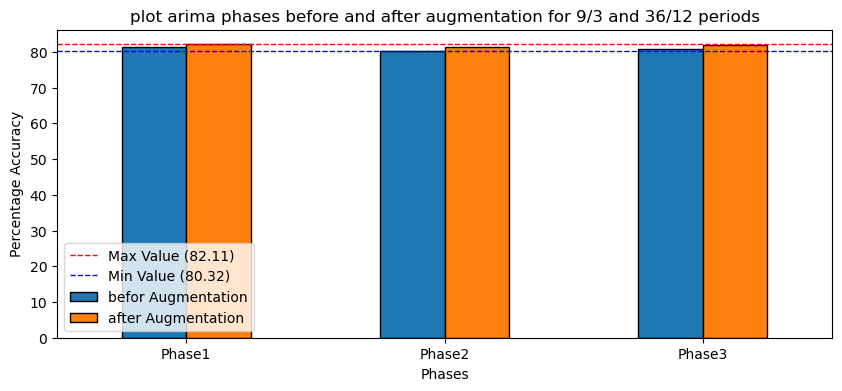

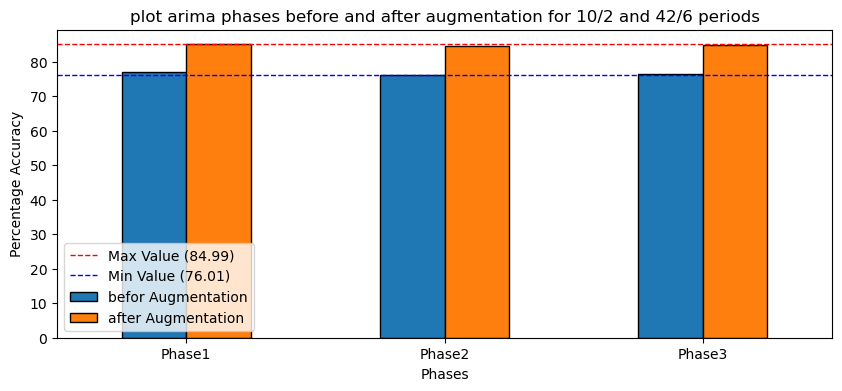

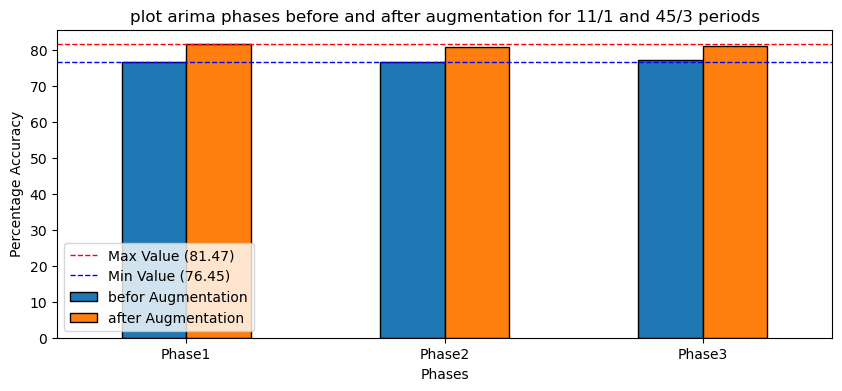

In [40]:

# Create the DataFrame
arima_period1 = pd.DataFrame({
    'Phases': ['Phase1', 'Phase2', 'Phase3'],
    'befor Augmentation': [81.35, 80.32, 80.74],
    'after Augmentation': [82.11, 81.41, 82.01],
})

arima_period2 = pd.DataFrame({
    'Phases': ['Phase1', 'Phase2', 'Phase3'],
    'befor Augmentation': [77.00, 76.01, 76.37],
    'after Augmentation': [84.99, 84.60, 84.88],
})

arima_period3 = pd.DataFrame({
    'Phases': ['Phase1', 'Phase2', 'Phase3'],
    'befor Augmentation': [76.46, 76.45, 77.01],
    'after Augmentation': [81.47, 80.75, 81.12],
})


arima_period1.set_index('Phases', inplace=True)
bar_plot2(arima_period1, 'plot arima phases before and after augmentation for 9/3 and 36/12 periods')

arima_period2.set_index('Phases', inplace=True)
bar_plot2(arima_period2, 'plot arima phases before and after augmentation for 10/2 and 42/6 periods')

arima_period3.set_index('Phases', inplace=True)
bar_plot2(arima_period3, 'plot arima phases before and after augmentation for 11/1 and 45/3 periods')



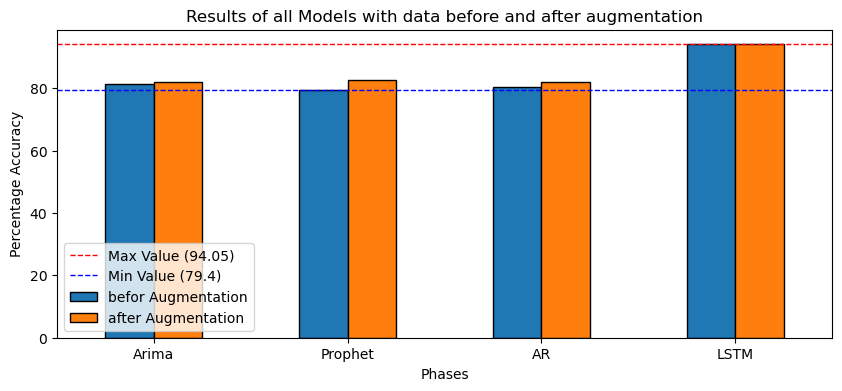

In [11]:
comp1 = pd.DataFrame({
    'Models': ['Arima', 'Prophet', 'AR', 'LSTM'],
    'befor Augmentation': [81.35, 79.40, 80.54, 94.05],
    'after Augmentation': [82.11, 82.51, 81.94, 94.04],
})

comp1.set_index('Models', inplace=True)
bar_plot2(comp1, 'Results of all Models with data before and after augmentation')


### Comparing Prophet results before and after Augmentaion

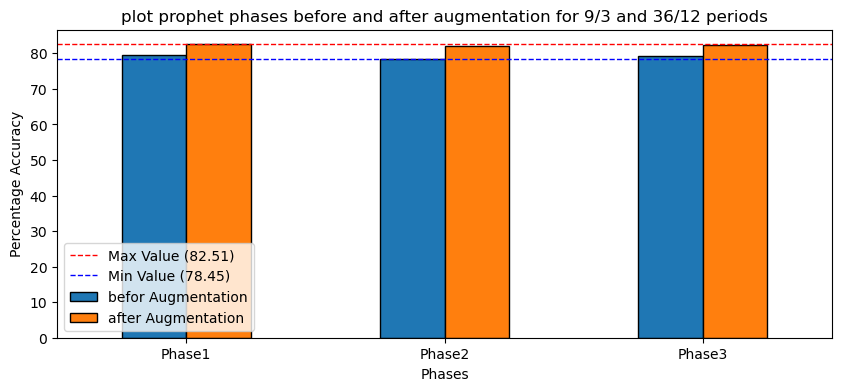

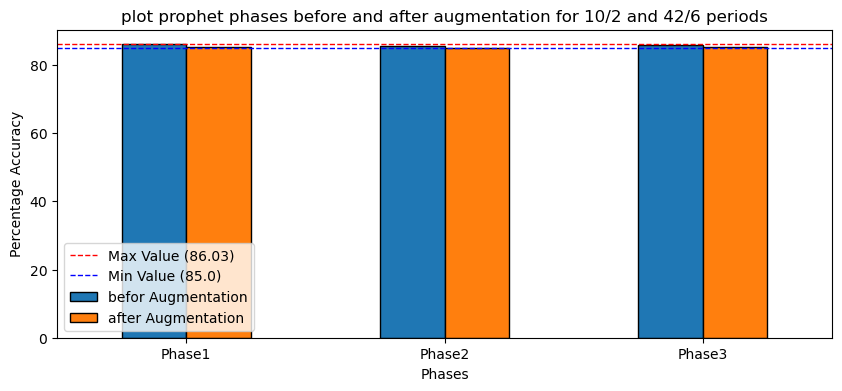

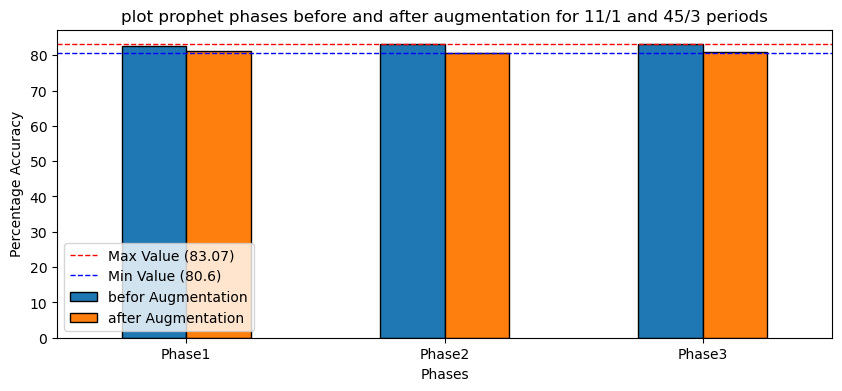

In [39]:

# Create the DataFrame
prophet_period1 = pd.DataFrame({
    'Phases': ['Phase1', 'Phase2', 'Phase3'],
    'befor Augmentation': [79.40, 78.45, 79.25],
    'after Augmentation': [82.51, 82.00, 82.28],
})

prophet_period2 = pd.DataFrame({
    'Phases': ['Phase1', 'Phase2', 'Phase3'],
    'befor Augmentation': [86.03, 85.55, 85.98],
    'after Augmentation': [85.38, 85.00, 85.26],
})

prophet_period3 = pd.DataFrame({
    'Phases': ['Phase1', 'Phase2', 'Phase3'],
    'befor Augmentation': [82.71, 83.06, 83.07],
    'after Augmentation': [81.07, 80.60, 80.93],
})


prophet_period1.set_index('Phases', inplace=True)
bar_plot2(prophet_period1, 'plot prophet phases before and after augmentation for 9/3 and 36/12 periods')

prophet_period2.set_index('Phases', inplace=True)
bar_plot2(prophet_period2, 'plot prophet phases before and after augmentation for 10/2 and 42/6 periods')

prophet_period3.set_index('Phases', inplace=True)
bar_plot2(prophet_period3, 'plot prophet phases before and after augmentation for 11/1 and 45/3 periods')

